In [ ]:
pip install natsort

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install wandb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 18.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 11.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 4.9 MB/s eta 0:00:00
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8807 sha256=87e2c4251661e26034979dcef738782f468ea5b2031967ec67aa85226d2b4eef
  Stored in directory: /root/.cache/pip/wheels/b7/0a/67/ada2a22079218c75a88361c0782855cc72aebc4d18d0289d05
Successfully built pathtools


In [ ]:
pip install gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import wandb
wandb.login()

<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
import os
import cv2
import zipfile 
import gdown
import torch; torch.manual_seed(0)
import torch.nn as nn
import torch.nn.functional as F
import torch.utils
import torch.distributions
import torchvision
import numpy as np
import matplotlib.pyplot as plt;
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
import torchvision.utils as vutils
import torch.optim as optim
from torch.autograd import grad
from torchvision import transforms
from torchvision import datasets as dtst
from natsort import natsorted
from PIL import Image
import matplotlib.animation as animation
import datetime
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow, imsave
%matplotlib inline
from tqdm import tqdm
from IPython.display import HTML

In [ ]:
torch.cuda.device_count()

1

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [ ]:
nc = 3

# Размер латентного вектора (размерность латентного пространства)
nz = 100

# Size of feature maps in generator
ngf = 64

# Рамер карты признаков для генератора
ndf = 64

image_size = 128

# Кол-во эпох
num_epochs = 5

# Лернингрейт
lr = 0.0002

# Параметр для оптимизатора Adam
beta1 = 0.5

# Количество GPU, 0 если считаем на CPU
ngpu = 1

In [ ]:
data_root = '/content/'
# Path to folder with the dataset
dataset_folder = f'{data_root}/celeba/img_align_celeba'
# URL for the CelebA dataset
url = 'https://drive.google.com/file/d/1-XiotU_k09UoPj7lPbU0XYRGZXf05oMc'
# Path to download the dataset to
download_path = f'{data_root}/celeba/img_align_celeba.zip'

In [ ]:
%%time
dtst.CelebA(data_root, download=True)

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

CPU times: user 33.4 s, sys: 14.4 s, total: 47.8 s
Wall time: 1min 11s


Dataset CelebA
    Number of datapoints: 162770
    Root location: /content/
    Target type: ['attr']
    Split: train

In [ ]:
with zipfile.ZipFile('/content/celeba/img_align_celeba.zip', 'r') as ziphandler:
    ziphandler.extractall(data_root)

In [ ]:
## Create a custom Dataset class
class CelebADataset(Dataset):
  def __init__(self, root_dir, transform=None):
    """
    Args:
      root_dir (string): Directory with all the images
      transform (callable, optional): transform to be applied to each image sample
    """
    # Read names of images in the root directory
    image_names = os.listdir(root_dir)

    self.root_dir = root_dir
    self.transform = transform 
    self.image_names = natsorted(image_names)

  def __len__(self): 
    return len(self.image_names)

  def __getitem__(self, idx):
    # Get the path to the image 
    img_path = os.path.join(self.root_dir, self.image_names[idx])
    # Load image and convert it to RGB
    img = Image.open(img_path).convert('RGB')
    # Apply transformations to the image
    if self.transform:
      img = self.transform(img)

    return img

In [ ]:
## Load the dataset 
# Path to directory with all the images
img_folder = f'/content/img_align_celeba/'

# Transformations to be applied to each individual image sample
transform=transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5],
                          std=[0.5, 0.5, 0.5])
])

In [ ]:
# Load the dataset from file and apply transformations
celeba_dataset = CelebADataset(img_folder, transform)

# Метки для реальных данных и фековых
real_label = 1.
fake_label = 0.

batch_size = 256 
# Number of workers for the dataloader
num_workers = 0
# Whether to put fetched data tensors to pinned memory
pin_memory = True 

celeba_dataloader = torch.utils.data.DataLoader(celeba_dataset,
                                                batch_size=batch_size,
                                                num_workers=num_workers,
                                                pin_memory=pin_memory,
                                                drop_last=True,
                                                shuffle=True)

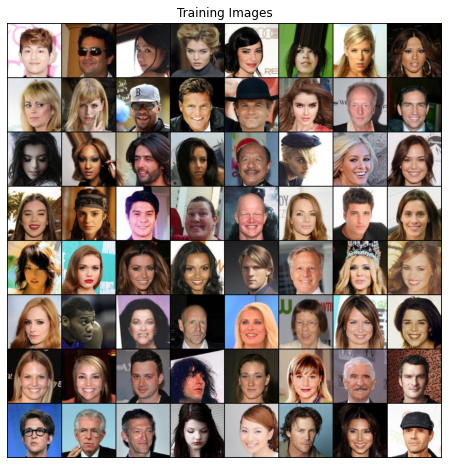

In [ ]:
real_batch = next(iter(celeba_dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[:64].to(device), padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
class ScpBlock(nn.Module):
    def forward(self, input):
        size = len(input[0])//2
        upsample = nn.Upsample(scale_factor=2,mode='bilinear').to(device)
        x1 = input[:,size:]
        x2 = input[:,: size]
        block = nn.Sequential(nn.Conv2d(in_channels=size, out_channels=size, kernel_size=1, stride=1),
                          nn.ReLU(True),
                          nn.Upsample(scale_factor=2,mode='bilinear'),
                          nn.Conv2d(in_channels=size, out_channels=size, kernel_size=3, padding=1),
                          nn.ReLU(True),
                          nn.Conv2d(in_channels=size, out_channels=size, kernel_size=3, padding=1)).to(device)
        return block(x1) + upsample(x2)
        

In [ ]:
class Generator(ScpBlock, nn.Module):
    def __init__(self,ScpBlock):
        super(Generator, self).__init__()
        super(ScpBlock, self).__init__()
        self.scp = ScpBlock()
        self.convT1 = nn.ConvTranspose2d(nz, ngf * 16, 4, 1, 0, bias=False)
    def forward(self, input):
        x = self.convT1(input)
        x = self.scp(x)
        x = self.scp(x)
        x = self.scp(x)
        x = self.scp(x)
        convT = nn.ConvTranspose2d(len(x[0]), nc, 2, 2, 0, bias=False).to(device)
        return convT(x)

In [ ]:
netG = Generator(ScpBlock).to(device)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
      super(Discriminator, self).__init__()
      self.main = nn.Sequential(
            nn.Conv2d(nc, 128, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # # input is (nc) x 64 x 64
            nn.Conv2d(128, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4,4, 1, bias=False),
#             nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
netD = Discriminator().to(device)

In [ ]:
# Инициализируем лосс
criterion = nn.BCELoss()

# Создаем батч с рандомным шумом для генерации
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

In [ ]:
# Устанавливаем оптимизаторы для G и D
optimizerD = optim.Adam(netD.parameters(), lr=lr/10, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(num_epochs):
    # Для каждого батча
    for i, data in enumerate(tqdm(celeba_dataloader, total=len(celeba_dataloader)), 0):

        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Для батча
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой прогон батча из реальных картинок D
        output = netD(real_cpu).view(-1)
        # Считаем лосс на всем батче реальных картинок

        errD_real = criterion(output, label)
        # Вычисляем градиенты для дискриминатора
        errD_real.backward()
        D_x = output.mean().item()

        ## Учим на полном фейковом батче
        # Генерируем батч латентных векторов
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Генерируем фековый батч с помощью G
        fake = netG(noise)
        label.fill_(fake_label)
        # Классифицируем фековый батч с помощью D
        output = netD(fake.detach()).view(-1)
        # Вычисляем лосс дискриминатора на фейковом батче
        errD_fake = criterion(output, label)
        # Вычисляем градиент для фейкового батча, он суммируется с предидущим
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Вычисляем ошибку на реальном и фековом батчах
        errD = errD_real + errD_fake
        # Обновляем веса D
        optimizerD.step()

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # для генератора фейковые метки есть реальные (0 меняем на 1)
        # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
        output = netD(fake).view(-1)
        # Вычислим лосс G основываясь на выходе D
        errG = criterion(output, label)
        # Вычислим градиент для G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Обновляем веса G
        optimizerG.step()

        # Выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(celeba_dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраним лоссы
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Проверим какие картинки рисует генератор
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(celeba_dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        torch.cuda.empty_cache()
        iters += 1

In [ ]:
# del real_cpu,label, b_size, output, errD_fake, D_x, noise, fake, errD_real
# del D_G_z2, errG


In [ ]:
noise = torch.randn(3, nz, 1, 1, device=device)
fake = netG(noise)
fake.shape

torch.Size([3, 3, 128, 128])

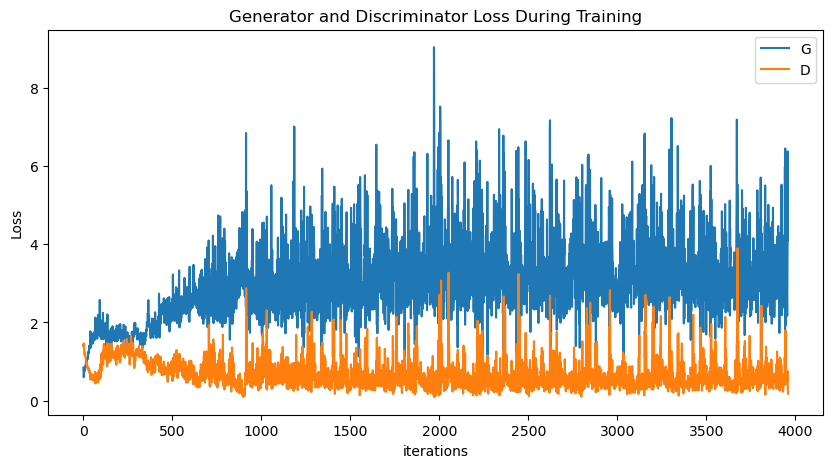

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

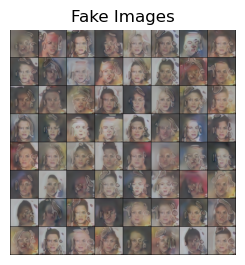

In [ ]:
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0))[:1042])
plt.show()

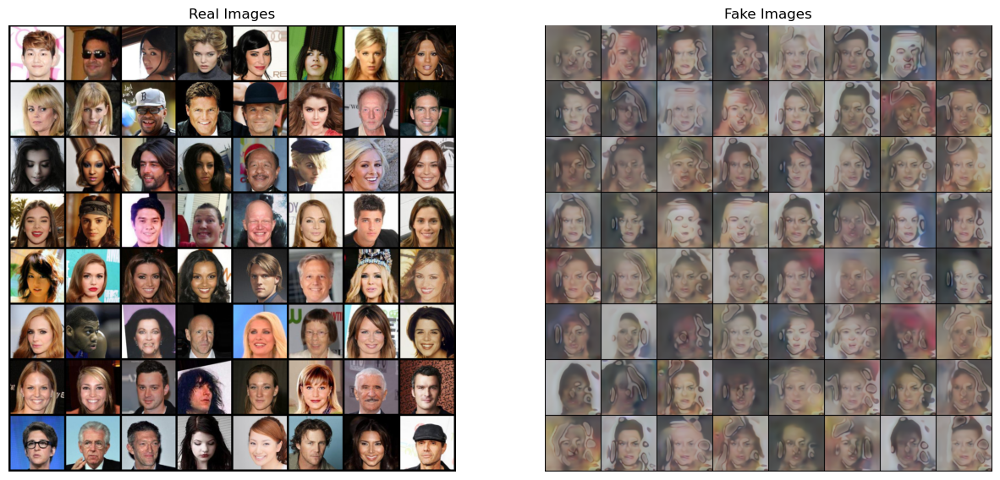

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(celeba_dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[:64].to(device), padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0))[:1042])
plt.show()

Если приглядеться то будет одно и тоже выражение лица, MODE COLLAPS

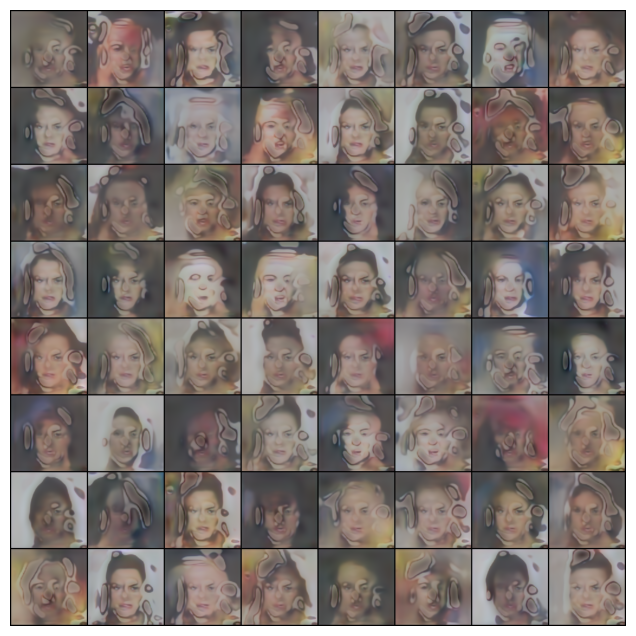

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
np.transpose(img_list[-1],(1,2,0))[:1042]
ims = [[plt.imshow(np.transpose(i,(1,2,0))[:1042], animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

# GAN на ResidualBlock
тут у меня были проблемы по памяти, поэтому можно не смотреть

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, inplanes, planes, kernel_size=3, stride=1, downsample=None, groups=1):
        super(ResidualBlock, self).__init__()
        p = kernel_size//2
        self.conv1 = nn.Sequential(
            nn.Conv2d(inplanes, planes, kernel_size, stride=stride, padding=p),
            nn.LeakyReLU(0.2)
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(planes, planes, kernel_size, padding=p),
            nn.LeakyReLU(0.2)
        )
        self.proj = nn.Conv2d(inplanes, planes, 1) if inplanes != planes else None
    
    def forward(self, x):
        identity = x
        
        y = self.conv1(x)
        y = self.conv2(y)
        
        identity = identity if self.proj is None else self.proj(identity)
        y = y + identity
        return y

In [ ]:
class Discriminator(nn.Module):
    """
        Convolutional Discriminator
    """
    def __init__(self):
        super(Discriminator, self).__init__()
        self.D = nn.Sequential(
            nn.Conv2d(3, 64, 3, padding=1), # (N, 64, 64, 64)
            ResidualBlock(64, 128),
            nn.AvgPool2d(3, 2, padding=1), # (N, 128, 32, 32)
            ResidualBlock(128, 256),
            nn.AvgPool2d(3, 4, padding=1), # (N, 256, 16, 16)
        )
        self.fc = nn.Linear(256*16*16, 1) # (N, 1)
        
    def forward(self, x):
        B = x.size(0)
        h = self.D(x)
        h = h.view(B, -1)
        
        y = self.fc(h)
        return y

In [ ]:
D = Discriminator().to(device)

In [ ]:
criterion = nn.L1Loss()

In [ ]:
max_epoch = 20
step = 0

In [ ]:
lr_k = 0.001
gamma = 0.7
k_t = 0
log_term = 1000

In [ ]:
steps_per_epoch = len(celeba_dataloader.dataset) // 16
steps_per_epoch

12662

In [ ]:
def save_checkpoint(state, file_name='checkpoint.pth.tar'):
    torch.save(state, file_name)

In [ ]:
def r1loss(inputs, label=None):
    # non-saturating loss with R1 regularization
    l = -1 if label else 1
    return F.softplus(l*inputs).mean()
max_epoch = 20
step = 0
log_term = 1000
save_term = 1000
r1_gamma = 10
steps_per_epoch = len(celeba_dataloader) // batch_size
steps_per_epoch

3

In [ ]:
def get_sample_image(G, n_noise=100, n_samples=64):
    n_rows = int(np.sqrt(n_samples))
    z = (torch.rand(size=[n_samples, n_noise])*2-1).to(device) # U[-1, 1]
    x_fake = G(z)
    print(x_fake.shape)
    x_fake = torch.cat([torch.cat([x_fake[n_rows*j+i] for i in range(n_rows)], dim=1) for j in range(n_rows)], dim=2)
    print(x_fake.shape)
    result = tensor2img(x_fake)
    return result


In [ ]:
def tensor2img(tensor):
    img = (np.transpose(tensor.detach().cpu().numpy(), [1,2,0])+1)/2.
    return img

In [ ]:
class GeneratorWithResiduals(nn.Module):
    def __init__(self, out_channel=1, n_noise=batch_size):
        super(GeneratorWithResiduals, self).__init__()
        self.fc = nn.Linear(100, 128*4*4)
        self.G = nn.Sequential(
            ResidualBlock(128, 64),
            nn.Upsample(scale_factor=4, mode='bilinear'),
            ResidualBlock(64, 64),
            nn.Upsample(scale_factor=4, mode='bilinear'),
            nn.ConvTranspose2d(64, nc, 2, 2, 0, bias=False),
            nn.Sigmoid()
        )
        
    def forward(self, z):
        B = z.size(0)
        h = self.fc(z)
        h = h.view(B, 128, 4, 4)
        x = self.G(h)
        return x

In [ ]:
resG = GeneratorWithResiduals().to(device)

In [ ]:
D_opt = torch.optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))
G_opt = optim.Adam(resG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
os.mkdir('/kaggle/working/samples')

FileExistsError: [Errno 17] File exists: '/kaggle/working/samples'

In [ ]:
n_noise = 100
MODEL_NAME = 'gan'
for epoch in range(20):
    for idx, images in enumerate(tqdm(celeba_dataloader, total=len(celeba_dataloader))):
        resG.zero_grad()
        x = images.to(device)
        x.requires_grad = True
        x_outputs = D(x)
        
        d_real_loss = r1loss(x_outputs, True)
        grad_real = grad(outputs=x_outputs.sum(), inputs=x, create_graph=True)[0]
        grad_penalty = (grad_real.view(grad_real.size(0), -1).norm(2, dim=1) ** 2).mean()
        grad_penalty = 0.5*r1_gamma*grad_penalty
        D_x_loss = d_real_loss + grad_penalty

        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(device)
        x_fake = resG(z)
        z_outputs = D(x_fake.detach())
        D_z_loss = r1loss(z_outputs, False)
        D_loss = D_x_loss + D_z_loss
        
        D.zero_grad()
        D_loss.backward()
        D_opt.step()

        # Training Generator
        z = (torch.rand(size=[batch_size, n_noise])*2-1).to(device)
        x_fake = resG(z)
        z_outputs = D(x_fake)
        G_loss = r1loss(z_outputs, True)
        
        resG.zero_grad()
        G_loss.backward()
        G_opt.step()
        
        if step % 10000 == 0:
            dt = datetime.datetime.now().strftime('%H:%M:%S')
            print('Epoch: {}/{}, Step: {}, D Loss: {:.4f}, G Loss: {:.4f}, gp: {:.4f}, Time:{}'.format(epoch, max_epoch, step, D_loss.item(), G_loss.item(), grad_penalty.item(), dt))
            resG.eval()
            img = get_sample_image(resG, n_noise, n_samples=25)
            imsave('samples/{}_step{:06d}.jpg'.format(MODEL_NAME, step), img)
            resG.train()
        
        del x,x_outputs, d_real_loss, grad_penalty,D_x_loss, z, x_fake, z_outputs, G_loss
        del D_z_loss, D_loss
        torch.cuda.empty_cache()
        step += 1

  0%|          | 0/792 [00:02<?, ?it/s]


OutOfMemoryError: CUDA out of memory. Tried to allocate 1024.00 MiB (GPU 0; 14.76 GiB total capacity; 11.93 GiB already allocated; 3.75 MiB free; 13.71 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [ ]:
import gc
gc.collect()

46

In [ ]:
torch.cuda.empty_cache()

# GAN из головы

In [ ]:
class GeneratorV1(nn.Module):
  def __init__(self):
    super(GeneratorV1, self).__init__()
    self.fc1 =  nn.Linear(100, 1024)
    self.batch_norm = nn.BatchNorm1d(1024)
    self.relu = nn.ReLU(True)
    self.fc2 =  nn.Linear(1024, 256*8*8)
    self.batch_norm1 = nn.BatchNorm1d(256*8*8)
    self.convT1 = nn.ConvTranspose2d(256, 128, 8, 8, 0, bias=False)
    self.upsample = nn.Upsample(scale_factor=2,mode='bilinear')
    self.convT2 = nn.ConvTranspose2d(128, 128, 4, 4, 0, bias=False)
    self.conv1 = nn.Conv2d(128, 3, 1, 1, 0, bias=False)
    self.sigmoid = nn.Sigmoid()
  def forward(self, input):
    x = self.fc1(input)
    x = self.batch_norm(x)
    x = self.relu(x)
    x = self.fc2(x)
    x = self.batch_norm1(x)
    x = self.relu(x)
    x = x.view(batch_size, 256,8,8)
    x = self.convT1(x)
    x = self.relu(x)
    x = self.upsample(x)
    x = self.conv1(x)
    return(x)

In [ ]:
G = GeneratorV1().to(device)

In [ ]:
x = torch.randn(batch_size, nz, device=device)
G(x).shape

torch.Size([256, 3, 128, 128])

In [ ]:
class DiscriminatorV1(nn.Module):
  def __init__(self):
    super(DiscriminatorV1, self).__init__()
    self.conv1 = nn.Conv2d(3, 64, 4, 4, bias=False)
    self.lRelu = nn.ReLU()
    self.conv2 = nn.Conv2d(64, 16, 8, 4, bias=False)
    self.conv3 =  nn.Conv2d(16, 1, 8,4, 1, bias=False)
    self.sigmoid = nn.Sigmoid()
    # self.fc = nn.Linear(64, )
  def forward(self, input):
    x = self.conv1(input)
    x = self.lRelu(x)
    x = self.conv2(x)
    x = self.lRelu(x)
    x = self.conv3(x)
    
    return self.sigmoid(x)

In [ ]:
D = DiscriminatorV1().to(device)

In [ ]:
optimizerD = optim.Adam(D.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(G.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
fixed_noize = torch.randn(batch_size, nz, device=device)

In [ ]:
criterion = nn.BCELoss()

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(num_epochs):
    # Для каждого батча
    for i, data in enumerate(tqdm(celeba_dataloader, total=len(celeba_dataloader)), 0):
        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        D.zero_grad()
        # Для батча
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой прогон батча из реальных картинок D
        output = D(real_cpu).view(-1)
        # Считаем лосс на всем батче реальных картинок

        errD_real = criterion(output, label)
        # Вычисляем градиенты для дискриминатора
        errD_real.backward()
        D_x = output.mean().item()

        ## Учим на полном фейковом батче
        # Генерируем батч латентных векторов
        noise = torch.randn(b_size, nz, device=device)
        # Генерируем фековый батч с помощью G
        fake = G(noise)
        label.fill_(fake_label)
        # Классифицируем фековый батч с помощью D
        output = D(fake.detach()).view(-1)
        # Вычисляем лосс дискриминатора на фейковом батче
        errD_fake = criterion(output, label)
        # Вычисляем градиент для фейкового батча, он суммируется с предидущим
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Вычисляем ошибку на реальном и фековом батчах
        errD = errD_real + errD_fake
        # Обновляем веса D
        optimizerD.step()

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        G.zero_grad()
        label.fill_(real_label)  # для генератора фейковые метки есть реальные (0 меняем на 1)
        # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
        output = D(fake).view(-1)
        # Вычислим лосс G основываясь на выходе D
        errG = criterion(output, label)
        # Вычислим градиент для G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Обновляем веса G
        optimizerG.step()

        # Выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(celeba_dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраним лоссы
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Проверим какие картинки рисует генератор
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(celeba_dataloader)-1)):
            with torch.no_grad():
                fake = G(fixed_noize).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


  0%|          | 1/791 [00:03<40:43,  3.09s/it]

[0/5][0/791]	Loss_D: 1.2201	Loss_G: 0.6110	D(x): 0.6447	D(G(z)): 0.5416 / 0.5428


  6%|▋         | 51/791 [02:31<39:32,  3.21s/it]

[0/5][50/791]	Loss_D: 0.7824	Loss_G: 1.1640	D(x): 0.8180	D(G(z)): 0.4366 / 0.3124


 13%|█▎        | 101/791 [05:01<33:03,  2.88s/it]

[0/5][100/791]	Loss_D: 0.7798	Loss_G: 0.9853	D(x): 0.9028	D(G(z)): 0.4827 / 0.3734


 19%|█▉        | 151/791 [07:22<29:58,  2.81s/it]

[0/5][150/791]	Loss_D: 0.5924	Loss_G: 0.9454	D(x): 0.9525	D(G(z)): 0.4141 / 0.3886


 25%|██▌       | 201/791 [09:43<27:54,  2.84s/it]

[0/5][200/791]	Loss_D: 0.6921	Loss_G: 0.7791	D(x): 0.9509	D(G(z)): 0.4677 / 0.4588


 32%|███▏      | 251/791 [12:04<28:50,  3.21s/it]

[0/5][250/791]	Loss_D: 0.7113	Loss_G: 0.8984	D(x): 0.9007	D(G(z)): 0.4401 / 0.4073


 38%|███▊      | 301/791 [14:35<23:35,  2.89s/it]

[0/5][300/791]	Loss_D: 0.9092	Loss_G: 0.6253	D(x): 0.9827	D(G(z)): 0.5894 / 0.5351


 44%|████▍     | 351/791 [17:03<21:54,  2.99s/it]

[0/5][350/791]	Loss_D: 0.8614	Loss_G: 0.6742	D(x): 0.9286	D(G(z)): 0.5247 / 0.5101


 51%|█████     | 401/791 [19:34<19:22,  2.98s/it]

[0/5][400/791]	Loss_D: 1.0463	Loss_G: 0.5751	D(x): 0.8345	D(G(z)): 0.5726 / 0.5631


 57%|█████▋    | 451/791 [22:00<16:23,  2.89s/it]

[0/5][450/791]	Loss_D: 1.2586	Loss_G: 0.4832	D(x): 0.7941	D(G(z)): 0.6330 / 0.6184


 63%|██████▎   | 501/791 [24:33<15:23,  3.19s/it]

[0/5][500/791]	Loss_D: 1.3164	Loss_G: 0.4942	D(x): 0.7163	D(G(z)): 0.6191 / 0.6116


 70%|██████▉   | 551/791 [27:05<11:46,  2.94s/it]

[0/5][550/791]	Loss_D: 1.3739	Loss_G: 0.4854	D(x): 0.6735	D(G(z)): 0.6196 / 0.6169


 76%|███████▌  | 601/791 [29:35<09:32,  3.01s/it]

[0/5][600/791]	Loss_D: 1.3705	Loss_G: 0.5147	D(x): 0.6443	D(G(z)): 0.6023 / 0.5988


 82%|████████▏ | 651/791 [32:10<07:25,  3.18s/it]

[0/5][650/791]	Loss_D: 1.3989	Loss_G: 0.5366	D(x): 0.6167	D(G(z)): 0.5970 / 0.5854


 89%|████████▊ | 701/791 [34:45<04:20,  2.89s/it]

[0/5][700/791]	Loss_D: 1.4037	Loss_G: 0.5425	D(x): 0.6071	D(G(z)): 0.5929 / 0.5821


 95%|█████████▍| 751/791 [37:13<01:56,  2.92s/it]

[0/5][750/791]	Loss_D: 1.4304	Loss_G: 0.5612	D(x): 0.5718	D(G(z)): 0.5800 / 0.5711


  0%|          | 1/791 [00:01<13:36,  1.03s/it]

[1/5][0/791]	Loss_D: 1.4012	Loss_G: 0.6112	D(x): 0.5438	D(G(z)): 0.5464 / 0.5429


  6%|▋         | 51/791 [00:51<11:59,  1.03it/s]

[1/5][50/791]	Loss_D: 1.4033	Loss_G: 0.6236	D(x): 0.5311	D(G(z)): 0.5364 / 0.5362


 13%|█▎        | 101/791 [01:42<12:22,  1.08s/it]

[1/5][100/791]	Loss_D: 1.4038	Loss_G: 0.6372	D(x): 0.5252	D(G(z)): 0.5317 / 0.5290


 19%|█▉        | 151/791 [02:33<10:53,  1.02s/it]

[1/5][150/791]	Loss_D: 1.4031	Loss_G: 0.6459	D(x): 0.5189	D(G(z)): 0.5259 / 0.5243


 25%|██▌       | 201/791 [03:25<10:03,  1.02s/it]

[1/5][200/791]	Loss_D: 1.3990	Loss_G: 0.6439	D(x): 0.5225	D(G(z)): 0.5273 / 0.5254


 32%|███▏      | 251/791 [04:16<09:55,  1.10s/it]

[1/5][250/791]	Loss_D: 1.3985	Loss_G: 0.6709	D(x): 0.5066	D(G(z)): 0.5123 / 0.5113


 38%|███▊      | 301/791 [05:08<08:24,  1.03s/it]

[1/5][300/791]	Loss_D: 1.3934	Loss_G: 0.6653	D(x): 0.5117	D(G(z)): 0.5148 / 0.5142


 44%|████▍     | 351/791 [06:01<08:14,  1.12s/it]

[1/5][350/791]	Loss_D: 1.3924	Loss_G: 0.6914	D(x): 0.4982	D(G(z)): 0.5012 / 0.5009


 51%|█████     | 401/791 [06:54<06:51,  1.06s/it]

[1/5][400/791]	Loss_D: 1.3900	Loss_G: 0.6848	D(x): 0.5027	D(G(z)): 0.5045 / 0.5042


 57%|█████▋    | 451/791 [07:47<05:51,  1.03s/it]

[1/5][450/791]	Loss_D: 1.3878	Loss_G: 0.6752	D(x): 0.5090	D(G(z)): 0.5095 / 0.5091


 63%|██████▎   | 501/791 [08:41<04:58,  1.03s/it]

[1/5][500/791]	Loss_D: 1.3870	Loss_G: 0.6920	D(x): 0.5004	D(G(z)): 0.5007 / 0.5006


 70%|██████▉   | 551/791 [09:36<04:18,  1.08s/it]

[1/5][550/791]	Loss_D: 1.3871	Loss_G: 0.6925	D(x): 0.5002	D(G(z)): 0.5006 / 0.5003


 76%|███████▌  | 601/791 [10:31<03:41,  1.16s/it]

[1/5][600/791]	Loss_D: 1.3865	Loss_G: 0.6916	D(x): 0.5008	D(G(z)): 0.5010 / 0.5008


 82%|████████▏ | 651/791 [11:27<02:30,  1.08s/it]

[1/5][650/791]	Loss_D: 1.3868	Loss_G: 0.6920	D(x): 0.5004	D(G(z)): 0.5007 / 0.5006


 89%|████████▊ | 701/791 [12:22<01:36,  1.08s/it]

[1/5][700/791]	Loss_D: 1.3860	Loss_G: 0.6921	D(x): 0.5008	D(G(z)): 0.5006 / 0.5005


 95%|█████████▍| 751/791 [13:16<00:43,  1.09s/it]

[1/5][750/791]	Loss_D: 1.3862	Loss_G: 0.6900	D(x): 0.5016	D(G(z)): 0.5016 / 0.5016


  0%|          | 1/791 [00:00<12:03,  1.09it/s]

[2/5][0/791]	Loss_D: 1.3865	Loss_G: 0.6921	D(x): 0.5002	D(G(z)): 0.5003 / 0.5005


  6%|▋         | 51/791 [00:47<11:34,  1.07it/s]

[2/5][50/791]	Loss_D: 1.3880	Loss_G: 0.6814	D(x): 0.5053	D(G(z)): 0.5061 / 0.5059


 13%|█▎        | 101/791 [01:34<10:39,  1.08it/s]

[2/5][100/791]	Loss_D: 1.3865	Loss_G: 0.6947	D(x): 0.4994	D(G(z)): 0.4995 / 0.4992


 19%|█▉        | 151/791 [02:23<10:58,  1.03s/it]

[2/5][150/791]	Loss_D: 1.3860	Loss_G: 0.6964	D(x): 0.4987	D(G(z)): 0.4986 / 0.4984


 25%|██▌       | 201/791 [03:13<10:15,  1.04s/it]

[2/5][200/791]	Loss_D: 1.3860	Loss_G: 0.6945	D(x): 0.4996	D(G(z)): 0.4994 / 0.4993


 32%|███▏      | 251/791 [04:12<09:19,  1.04s/it]

[2/5][250/791]	Loss_D: 1.3844	Loss_G: 0.6869	D(x): 0.5034	D(G(z)): 0.5024 / 0.5032


 38%|███▊      | 301/791 [05:05<08:51,  1.08s/it]

[2/5][300/791]	Loss_D: 1.3868	Loss_G: 0.6923	D(x): 0.5002	D(G(z)): 0.5005 / 0.5004


 44%|████▍     | 351/791 [05:58<07:34,  1.03s/it]

[2/5][350/791]	Loss_D: 1.3862	Loss_G: 0.6932	D(x): 0.5000	D(G(z)): 0.5000 / 0.4999


 51%|█████     | 401/791 [06:56<07:50,  1.21s/it]

[2/5][400/791]	Loss_D: 1.3863	Loss_G: 0.6934	D(x): 0.4999	D(G(z)): 0.4999 / 0.4999


 57%|█████▋    | 451/791 [07:53<05:56,  1.05s/it]

[2/5][450/791]	Loss_D: 1.3864	Loss_G: 0.6931	D(x): 0.5000	D(G(z)): 0.5000 / 0.5000


 63%|██████▎   | 501/791 [08:47<05:10,  1.07s/it]

[2/5][500/791]	Loss_D: 1.3864	Loss_G: 0.6931	D(x): 0.5000	D(G(z)): 0.5000 / 0.5000


 70%|██████▉   | 551/791 [09:40<04:16,  1.07s/it]

[2/5][550/791]	Loss_D: 1.3863	Loss_G: 0.6931	D(x): 0.5000	D(G(z)): 0.5000 / 0.5000


 76%|███████▌  | 601/791 [10:34<03:18,  1.04s/it]

[2/5][600/791]	Loss_D: 1.3862	Loss_G: 0.6931	D(x): 0.5001	D(G(z)): 0.5000 / 0.5000


 82%|████████▏ | 651/791 [11:28<02:29,  1.07s/it]

[2/5][650/791]	Loss_D: 1.3863	Loss_G: 0.6931	D(x): 0.5000	D(G(z)): 0.5000 / 0.5000


 89%|████████▊ | 701/791 [12:23<01:35,  1.06s/it]

[2/5][700/791]	Loss_D: 1.3862	Loss_G: 0.6933	D(x): 0.5000	D(G(z)): 0.4999 / 0.4999


 95%|█████████▍| 751/791 [13:16<00:44,  1.11s/it]

[2/5][750/791]	Loss_D: 1.3865	Loss_G: 0.6930	D(x): 0.5000	D(G(z)): 0.5001 / 0.5001


  0%|          | 1/791 [00:00<12:46,  1.03it/s]

[3/5][0/791]	Loss_D: 1.3862	Loss_G: 0.6930	D(x): 0.5001	D(G(z)): 0.5001 / 0.5001


  6%|▋         | 51/791 [00:48<12:02,  1.02it/s]

[3/5][50/791]	Loss_D: 1.3860	Loss_G: 0.6930	D(x): 0.5002	D(G(z)): 0.5001 / 0.5001


 13%|█▎        | 101/791 [01:36<10:46,  1.07it/s]

[3/5][100/791]	Loss_D: 1.3864	Loss_G: 0.6936	D(x): 0.4997	D(G(z)): 0.4998 / 0.4998


 19%|█▉        | 151/791 [02:24<10:05,  1.06it/s]

[3/5][150/791]	Loss_D: 1.3863	Loss_G: 0.6933	D(x): 0.4999	D(G(z)): 0.4999 / 0.4999


 25%|██▌       | 201/791 [03:12<09:28,  1.04it/s]

[3/5][200/791]	Loss_D: 1.3861	Loss_G: 0.6923	D(x): 0.5006	D(G(z)): 0.5005 / 0.5004


 32%|███▏      | 251/791 [04:02<08:47,  1.02it/s]

[3/5][250/791]	Loss_D: 1.3863	Loss_G: 0.6932	D(x): 0.5000	D(G(z)): 0.5000 / 0.5000


 38%|███▊      | 301/791 [04:51<08:05,  1.01it/s]

[3/5][300/791]	Loss_D: 1.3862	Loss_G: 0.6937	D(x): 0.4998	D(G(z)): 0.4998 / 0.4997


 44%|████▍     | 351/791 [05:41<07:11,  1.02it/s]

[3/5][350/791]	Loss_D: 1.3869	Loss_G: 0.6924	D(x): 0.5002	D(G(z)): 0.5005 / 0.5004


 51%|█████     | 401/791 [06:32<06:44,  1.04s/it]

[3/5][400/791]	Loss_D: 1.3863	Loss_G: 0.6934	D(x): 0.4999	D(G(z)): 0.4999 / 0.4999


 57%|█████▋    | 451/791 [07:24<06:13,  1.10s/it]

[3/5][450/791]	Loss_D: 1.3867	Loss_G: 0.6922	D(x): 0.5004	D(G(z)): 0.5006 / 0.5005


 63%|██████▎   | 501/791 [08:17<05:17,  1.09s/it]

[3/5][500/791]	Loss_D: 1.3867	Loss_G: 0.6932	D(x): 0.4998	D(G(z)): 0.5000 / 0.5000


 70%|██████▉   | 551/791 [09:10<04:11,  1.05s/it]

[3/5][550/791]	Loss_D: 1.3892	Loss_G: 0.6907	D(x): 0.5020	D(G(z)): 0.5034 / 0.5012


 76%|███████▌  | 601/791 [10:03<03:25,  1.08s/it]

[3/5][600/791]	Loss_D: 1.3858	Loss_G: 0.6911	D(x): 0.5016	D(G(z)): 0.5013 / 0.5010


 82%|████████▏ | 651/791 [10:58<02:23,  1.02s/it]

[3/5][650/791]	Loss_D: 1.3860	Loss_G: 0.6930	D(x): 0.5003	D(G(z)): 0.5001 / 0.5001


 89%|████████▊ | 701/791 [11:52<01:36,  1.07s/it]

[3/5][700/791]	Loss_D: 1.3866	Loss_G: 0.6931	D(x): 0.4998	D(G(z)): 0.5000 / 0.5000


 95%|█████████▍| 751/791 [12:45<00:45,  1.13s/it]

[3/5][750/791]	Loss_D: 1.3928	Loss_G: 0.6858	D(x): 0.5017	D(G(z)): 0.5048 / 0.5037


  0%|          | 1/791 [00:00<12:53,  1.02it/s]

[4/5][0/791]	Loss_D: 1.3862	Loss_G: 0.6930	D(x): 0.5000	D(G(z)): 0.5000 / 0.5001


  6%|▋         | 51/791 [00:48<12:06,  1.02it/s]

[4/5][50/791]	Loss_D: 1.3857	Loss_G: 0.6950	D(x): 0.4994	D(G(z)): 0.4991 / 0.4991


 13%|█▎        | 101/791 [01:36<11:47,  1.03s/it]

[4/5][100/791]	Loss_D: 1.3860	Loss_G: 0.6928	D(x): 0.5005	D(G(z)): 0.5003 / 0.5002


 19%|█▉        | 151/791 [02:25<10:39,  1.00it/s]

[4/5][150/791]	Loss_D: 1.3840	Loss_G: 0.6963	D(x): 0.5000	D(G(z)): 0.4988 / 0.4985


 25%|██▌       | 201/791 [03:14<09:22,  1.05it/s]

[4/5][200/791]	Loss_D: 1.3832	Loss_G: 0.6924	D(x): 0.5019	D(G(z)): 0.5003 / 0.5004


 32%|███▏      | 251/791 [04:04<08:50,  1.02it/s]

[4/5][250/791]	Loss_D: 1.3863	Loss_G: 0.6931	D(x): 0.5000	D(G(z)): 0.5000 / 0.5000


 38%|███▊      | 301/791 [04:54<08:14,  1.01s/it]

[4/5][300/791]	Loss_D: 1.3849	Loss_G: 0.6923	D(x): 0.5012	D(G(z)): 0.5004 / 0.5004


 44%|████▍     | 351/791 [05:45<07:23,  1.01s/it]

[4/5][350/791]	Loss_D: 1.3880	Loss_G: 0.6932	D(x): 0.4991	D(G(z)): 0.4999 / 0.5000


 51%|█████     | 401/791 [06:36<06:45,  1.04s/it]

[4/5][400/791]	Loss_D: 1.3860	Loss_G: 0.6931	D(x): 0.5002	D(G(z)): 0.5000 / 0.5000


 57%|█████▋    | 451/791 [07:28<05:48,  1.03s/it]

[4/5][450/791]	Loss_D: 1.3856	Loss_G: 0.7004	D(x): 0.4981	D(G(z)): 0.4975 / 0.4964


 63%|██████▎   | 501/791 [08:20<04:55,  1.02s/it]

[4/5][500/791]	Loss_D: 1.3861	Loss_G: 0.6931	D(x): 0.5001	D(G(z)): 0.5000 / 0.5000


 70%|██████▉   | 551/791 [09:13<04:17,  1.07s/it]

[4/5][550/791]	Loss_D: 1.3880	Loss_G: 0.6913	D(x): 0.5003	D(G(z)): 0.5012 / 0.5009


 76%|███████▌  | 601/791 [10:08<03:21,  1.06s/it]

[4/5][600/791]	Loss_D: 1.3871	Loss_G: 0.6932	D(x): 0.4996	D(G(z)): 0.5000 / 0.5000


 82%|████████▏ | 651/791 [11:04<02:34,  1.10s/it]

[4/5][650/791]	Loss_D: 1.3864	Loss_G: 0.6930	D(x): 0.5000	D(G(z)): 0.5001 / 0.5001


 89%|████████▊ | 701/791 [11:59<01:35,  1.07s/it]

[4/5][700/791]	Loss_D: 1.3863	Loss_G: 0.6931	D(x): 0.5000	D(G(z)): 0.5000 / 0.5000


 95%|█████████▍| 751/791 [12:55<00:46,  1.15s/it]

[4/5][750/791]	Loss_D: 1.3862	Loss_G: 0.6933	D(x): 0.5000	D(G(z)): 0.4999 / 0.4999


100%|██████████| 791/791 [13:41<00:00,  1.04s/it]


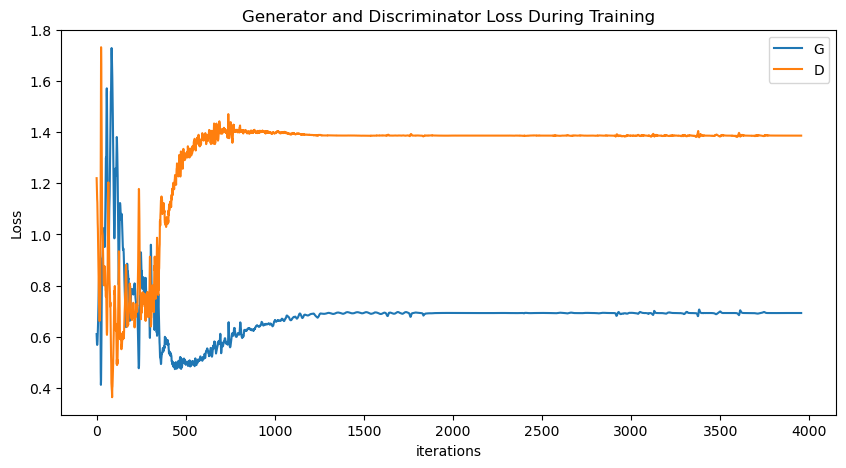

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

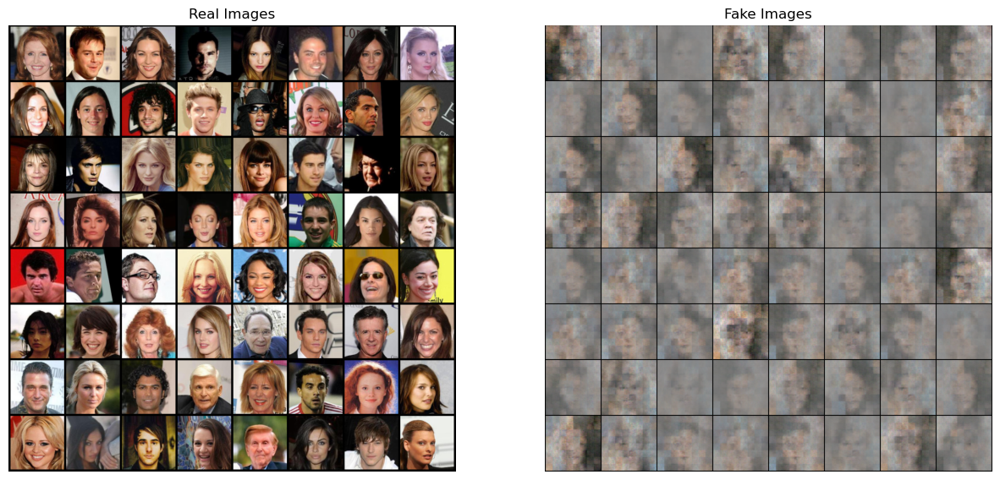

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(celeba_dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[:64].to(device), padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0))[:1042])
plt.show()

# Теперь на L1LOSS

In [ ]:
criterion = nn.L1Loss()

In [ ]:
max_epoch = 20
step = 0

In [ ]:
lr_k = 0.001
gamma = 0.7
k_t = 0
log_term = 1000

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
      super(Discriminator, self).__init__()
      self.main = nn.Sequential(
            nn.Conv2d(nc, 128, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # # input is (nc) x 64 x 64
            nn.Conv2d(128, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
#             # # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
#             nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ndf * 8),
#             nn.LeakyReLU(0.2, inplace=True),
#             # # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 4, 1,8,4, 1, bias=False),
#             nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
D2 = Discriminator().to(device)

In [ ]:
G2= GeneratorV1().to(device)

In [ ]:
optimizerD = optim.Adam(D2.parameters(), lr=lr/10, betas=(beta1, 0.999))
optimizerG = optim.Adam(G2.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
wandb.init(
    # set the wandb project where this run will be logged
    project="log_gan",
    
    # track hyperparameters and run metadata
    config={
    "learning_rate": 0.0002,
    "architecture": "gan",
    "dataset": "Celeba",
    "epochs": 20,
    }
)

wandb: Currently logged in as: zaraev-rob. Use `wandb login --relogin` to force relogin


In [46]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(max_epoch):
    # Для каждого батча
    for i, data in enumerate(tqdm(celeba_dataloader, total=len(celeba_dataloader)), 0):
        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        D2.zero_grad()
        # Для батча
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой прогон батча из реальных картинок D
        output = D2(real_cpu).view(-1)
        # Считаем лосс на всем батче реальных картинок

        errD_real = criterion(output, label)
        # Вычисляем градиенты для дискриминатора
        errD_real.backward()
        
        D_x = output.mean().item()

        ## Учим на полном фейковом батче
        # Генерируем батч латентных векторов
        noise = torch.randn(b_size, nz, device=device)
        # Генерируем фековый батч с помощью G
        fake = G2(noise)
        label.fill_(fake_label)
        # Классифицируем фековый батч с помощью D
        output = D2(fake.detach()).view(-1)
        # Вычисляем лосс дискриминатора на фейковом батче
        errD_fake = criterion(output, label)
        # Вычисляем градиент для фейкового батча, он суммируется с предидущим
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Вычисляем ошибку на реальном и фековом батчах
        errD = errD_real + errD_fake
        # Обновляем веса D
        optimizerD.step()

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        G2.zero_grad()
        label.fill_(real_label)  # для генератора фейковые метки есть реальные (0 меняем на 1)
        # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
        output = D2(fake).view(-1)
        # Вычислим лосс G основываясь на выходе D
        errG = criterion(output, label)
        # Вычислим градиент для G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Обновляем веса G
        optimizerG.step()

        # Выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, max_epoch, i, len(celeba_dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраним лоссы
        wandb.log({"errG": errG, "errD": errD, 'D(x)': D_x})
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Проверим какие картинки рисует генератор
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(celeba_dataloader)-1)):
            with torch.no_grad():
                fake = G2(fixed_noize).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


  0%|          | 0/791 [00:00<?, ?it/s]

[0/20][0/791]	Loss_D: 1.0794	Loss_G: 0.6195	D(x): 0.6720	D(G(z)): 0.6668 / 0.3860


  6%|▋         | 51/791 [01:20<20:08,  1.63s/it]

[0/20][50/791]	Loss_D: 1.6222	Loss_G: 0.2782	D(x): 0.5739	D(G(z)): 0.9787 / 0.8535


 13%|█▎        | 101/791 [02:36<18:12,  1.58s/it]

[0/20][100/791]	Loss_D: 1.3193	Loss_G: 0.8179	D(x): 0.1130	D(G(z)): 0.2957 / 0.1821


 19%|█▉        | 151/791 [03:52<16:48,  1.58s/it]

[0/20][150/791]	Loss_D: 0.8936	Loss_G: 0.9981	D(x): 0.5198	D(G(z)): 0.1048 / 0.0019


 25%|██▌       | 201/791 [05:08<15:42,  1.60s/it]

[0/20][200/791]	Loss_D: 0.9846	Loss_G: 0.7570	D(x): 0.2623	D(G(z)): 0.1023 / 0.2430


 32%|███▏      | 251/791 [06:23<14:25,  1.60s/it]

[0/20][250/791]	Loss_D: 0.7721	Loss_G: 0.8711	D(x): 0.6977	D(G(z)): 0.2851 / 0.1289


 38%|███▊      | 301/791 [07:40<13:04,  1.60s/it]

[0/20][300/791]	Loss_D: 0.6748	Loss_G: 0.7235	D(x): 0.4647	D(G(z)): 0.0055 / 0.2765


 44%|████▍     | 351/791 [08:56<11:50,  1.61s/it]

[0/20][350/791]	Loss_D: 0.8616	Loss_G: 0.7821	D(x): 0.4078	D(G(z)): 0.2582 / 0.2179


 51%|█████     | 401/791 [10:14<10:30,  1.62s/it]

[0/20][400/791]	Loss_D: 1.1291	Loss_G: 0.3274	D(x): 0.0117	D(G(z)): 0.0240 / 0.6871


 57%|█████▋    | 451/791 [11:30<09:11,  1.62s/it]

[0/20][450/791]	Loss_D: 0.9580	Loss_G: 0.7194	D(x): 0.4539	D(G(z)): 0.3850 / 0.2806


 63%|██████▎   | 500/791 [12:45<07:35,  1.56s/it]

[0/20][500/791]	Loss_D: 0.8888	Loss_G: 0.8063	D(x): 0.4248	D(G(z)): 0.2957 / 0.1937


 70%|██████▉   | 551/791 [14:04<06:25,  1.61s/it]

[0/20][550/791]	Loss_D: 0.8893	Loss_G: 0.8690	D(x): 0.5061	D(G(z)): 0.3466 / 0.1310


 76%|███████▌  | 601/791 [15:20<05:06,  1.61s/it]

[0/20][600/791]	Loss_D: 0.8907	Loss_G: 0.6055	D(x): 0.3874	D(G(z)): 0.2387 / 0.3945


 82%|████████▏ | 651/791 [16:35<03:42,  1.59s/it]

[0/20][650/791]	Loss_D: 0.8347	Loss_G: 0.8342	D(x): 0.4160	D(G(z)): 0.2393 / 0.1658


 89%|████████▊ | 701/791 [17:50<02:14,  1.50s/it]

[0/20][700/791]	Loss_D: 0.8738	Loss_G: 0.7473	D(x): 0.4436	D(G(z)): 0.3034 / 0.2527


 95%|█████████▍| 751/791 [19:05<00:57,  1.43s/it]

[0/20][750/791]	Loss_D: 0.9408	Loss_G: 0.7451	D(x): 0.3583	D(G(z)): 0.2869 / 0.2549


  0%|          | 1/791 [00:01<18:30,  1.41s/it]

[1/20][0/791]	Loss_D: 0.9054	Loss_G: 0.7635	D(x): 0.5050	D(G(z)): 0.4038 / 0.2365


  6%|▋         | 51/791 [01:14<17:30,  1.42s/it]

[1/20][50/791]	Loss_D: 0.8957	Loss_G: 0.6896	D(x): 0.4399	D(G(z)): 0.3245 / 0.3104


 13%|█▎        | 101/791 [02:28<16:55,  1.47s/it]

[1/20][100/791]	Loss_D: 0.9394	Loss_G: 0.6176	D(x): 0.4529	D(G(z)): 0.3827 / 0.3828


 19%|█▉        | 151/791 [03:41<16:47,  1.57s/it]

[1/20][150/791]	Loss_D: 0.8620	Loss_G: 0.7309	D(x): 0.4649	D(G(z)): 0.3146 / 0.2691


 25%|██▌       | 201/791 [04:54<13:54,  1.41s/it]

[1/20][200/791]	Loss_D: 0.7773	Loss_G: 0.8055	D(x): 0.5735	D(G(z)): 0.3290 / 0.1945


 32%|███▏      | 251/791 [06:08<12:44,  1.42s/it]

[1/20][250/791]	Loss_D: 0.8215	Loss_G: 0.6083	D(x): 0.4055	D(G(z)): 0.2164 / 0.3917


 38%|███▊      | 301/791 [07:21<11:58,  1.47s/it]

[1/20][300/791]	Loss_D: 0.9673	Loss_G: 0.5657	D(x): 0.5452	D(G(z)): 0.5055 / 0.4343


 44%|████▍     | 351/791 [08:34<11:07,  1.52s/it]

[1/20][350/791]	Loss_D: 0.8188	Loss_G: 0.7456	D(x): 0.4442	D(G(z)): 0.2597 / 0.2544


 51%|█████     | 401/791 [09:47<09:05,  1.40s/it]

[1/20][400/791]	Loss_D: 1.2161	Loss_G: 1.6945	D(x): 1.3029	D(G(z)): 0.8913 / -0.6945


 57%|█████▋    | 451/791 [11:00<08:05,  1.43s/it]

[1/20][450/791]	Loss_D: 0.8175	Loss_G: 0.7385	D(x): 0.5084	D(G(z)): 0.3195 / 0.2615


 63%|██████▎   | 501/791 [12:14<07:14,  1.50s/it]

[1/20][500/791]	Loss_D: 0.6428	Loss_G: 0.7183	D(x): 0.6592	D(G(z)): 0.2904 / 0.2817


 70%|██████▉   | 551/791 [13:27<05:58,  1.49s/it]

[1/20][550/791]	Loss_D: 1.0623	Loss_G: 0.1405	D(x): 0.1759	D(G(z)): -0.0468 / 0.9818


 76%|███████▌  | 601/791 [14:40<04:27,  1.41s/it]

[1/20][600/791]	Loss_D: 0.7470	Loss_G: 0.7784	D(x): 0.6655	D(G(z)): 0.3823 / 0.2216


 82%|████████▏ | 651/791 [15:53<03:23,  1.45s/it]

[1/20][650/791]	Loss_D: 0.8381	Loss_G: 0.6355	D(x): 0.5726	D(G(z)): 0.4030 / 0.3645


 89%|████████▊ | 701/791 [17:06<02:18,  1.54s/it]

[1/20][700/791]	Loss_D: 0.8271	Loss_G: 0.4693	D(x): 0.3829	D(G(z)): 0.1709 / 0.5307


 95%|█████████▍| 751/791 [18:19<00:58,  1.46s/it]

[1/20][750/791]	Loss_D: 1.0023	Loss_G: 0.5842	D(x): 0.4866	D(G(z)): 0.4808 / 0.4159


  0%|          | 1/791 [00:01<18:26,  1.40s/it]

[2/20][0/791]	Loss_D: 0.8724	Loss_G: 0.6941	D(x): 0.5697	D(G(z)): 0.4358 / 0.3059


  6%|▋         | 51/791 [01:14<17:29,  1.42s/it]

[2/20][50/791]	Loss_D: 0.9180	Loss_G: 0.6543	D(x): 0.7625	D(G(z)): 0.6352 / 0.3457


 13%|█▎        | 101/791 [02:27<17:05,  1.49s/it]

[2/20][100/791]	Loss_D: 0.7507	Loss_G: 0.3070	D(x): 0.4500	D(G(z)): 0.1661 / 0.6948


 19%|█▉        | 151/791 [03:39<15:34,  1.46s/it]

[2/20][150/791]	Loss_D: 0.6516	Loss_G: 0.8738	D(x): 0.7227	D(G(z)): 0.3381 / 0.1262


 25%|██▌       | 201/791 [04:52<13:48,  1.40s/it]

[2/20][200/791]	Loss_D: 0.7742	Loss_G: 0.6408	D(x): 0.5012	D(G(z)): 0.2687 / 0.3592


 32%|███▏      | 251/791 [06:05<13:11,  1.47s/it]

[2/20][250/791]	Loss_D: 0.8450	Loss_G: 0.6598	D(x): 0.6979	D(G(z)): 0.5126 / 0.3402


 38%|███▊      | 301/791 [07:17<12:34,  1.54s/it]

[2/20][300/791]	Loss_D: 0.8451	Loss_G: 0.5844	D(x): 0.5279	D(G(z)): 0.3667 / 0.4156


 44%|████▍     | 351/791 [08:30<10:13,  1.40s/it]

[2/20][350/791]	Loss_D: 0.9399	Loss_G: 0.1418	D(x): 0.6544	D(G(z)): 0.5785 / 0.8965


 51%|█████     | 401/791 [09:42<09:10,  1.41s/it]

[2/20][400/791]	Loss_D: 0.8510	Loss_G: 0.6557	D(x): 0.5277	D(G(z)): 0.3676 / 0.3443


 57%|█████▋    | 451/791 [10:56<08:31,  1.51s/it]

[2/20][450/791]	Loss_D: 0.9887	Loss_G: 0.7725	D(x): 0.4424	D(G(z)): 0.4292 / 0.2275


 63%|██████▎   | 501/791 [12:08<07:15,  1.50s/it]

[2/20][500/791]	Loss_D: 0.7550	Loss_G: 0.7672	D(x): 0.5728	D(G(z)): 0.3073 / 0.2328


 70%|██████▉   | 551/791 [13:20<05:36,  1.40s/it]

[2/20][550/791]	Loss_D: 0.8937	Loss_G: 0.5068	D(x): 0.6052	D(G(z)): 0.4816 / 0.4949


 76%|███████▌  | 601/791 [14:33<04:33,  1.44s/it]

[2/20][600/791]	Loss_D: 0.7589	Loss_G: 0.8823	D(x): 0.6048	D(G(z)): 0.3199 / 0.1177


 82%|████████▏ | 651/791 [15:47<03:36,  1.55s/it]

[2/20][650/791]	Loss_D: 0.8111	Loss_G: 0.7208	D(x): 0.4795	D(G(z)): 0.2753 / 0.2792


 89%|████████▊ | 701/791 [16:59<02:05,  1.40s/it]

[2/20][700/791]	Loss_D: 0.7947	Loss_G: 0.5998	D(x): 0.4824	D(G(z)): 0.2729 / 0.4002


 95%|█████████▍| 751/791 [18:12<00:56,  1.41s/it]

[2/20][750/791]	Loss_D: 0.9445	Loss_G: 0.6209	D(x): 0.5690	D(G(z)): 0.5084 / 0.3791


  0%|          | 1/791 [00:01<18:23,  1.40s/it]

[3/20][0/791]	Loss_D: 0.7913	Loss_G: 0.5089	D(x): 0.6402	D(G(z)): 0.4244 / 0.4911


  6%|▋         | 51/791 [01:14<18:48,  1.52s/it]

[3/20][50/791]	Loss_D: 1.0050	Loss_G: 0.8828	D(x): 0.3040	D(G(z)): 0.2980 / 0.1172


 13%|█▎        | 101/791 [02:26<15:57,  1.39s/it]

[3/20][100/791]	Loss_D: 1.0429	Loss_G: 0.5409	D(x): 0.2441	D(G(z)): 0.2399 / 0.4603


 19%|█▉        | 151/791 [03:39<15:07,  1.42s/it]

[3/20][150/791]	Loss_D: 0.9145	Loss_G: 0.5652	D(x): 0.4856	D(G(z)): 0.3934 / 0.4348


 25%|██▌       | 201/791 [04:52<14:45,  1.50s/it]

[3/20][200/791]	Loss_D: 0.9596	Loss_G: 0.7005	D(x): 0.5630	D(G(z)): 0.5168 / 0.2995


 32%|███▏      | 251/791 [06:04<13:18,  1.48s/it]

[3/20][250/791]	Loss_D: 0.9033	Loss_G: 0.4821	D(x): 0.5274	D(G(z)): 0.4257 / 0.5179


 38%|███▊      | 301/791 [07:17<11:25,  1.40s/it]

[3/20][300/791]	Loss_D: 0.8328	Loss_G: 0.7963	D(x): 0.5554	D(G(z)): 0.3799 / 0.2037


 44%|████▍     | 351/791 [08:29<10:38,  1.45s/it]

[3/20][350/791]	Loss_D: 0.9926	Loss_G: 0.7108	D(x): 0.3446	D(G(z)): 0.3353 / 0.2892


 51%|█████     | 401/791 [09:42<09:58,  1.53s/it]

[3/20][400/791]	Loss_D: 0.8805	Loss_G: 0.6012	D(x): 0.6268	D(G(z)): 0.4875 / 0.3988


 57%|█████▋    | 451/791 [10:54<07:53,  1.39s/it]

[3/20][450/791]	Loss_D: 0.6944	Loss_G: 0.9773	D(x): 0.5204	D(G(z)): 0.2010 / 0.0227


 63%|██████▎   | 501/791 [12:07<06:51,  1.42s/it]

[3/20][500/791]	Loss_D: 0.9104	Loss_G: 0.5920	D(x): 0.5279	D(G(z)): 0.4269 / 0.4080


 70%|██████▉   | 551/791 [13:19<06:04,  1.52s/it]

[3/20][550/791]	Loss_D: 0.9612	Loss_G: 0.6560	D(x): 0.4185	D(G(z)): 0.3739 / 0.3440


 76%|███████▌  | 601/791 [14:31<04:32,  1.44s/it]

[3/20][600/791]	Loss_D: 0.8342	Loss_G: 0.7035	D(x): 0.6009	D(G(z)): 0.4249 / 0.2965


 82%|████████▏ | 651/791 [15:44<03:15,  1.40s/it]

[3/20][650/791]	Loss_D: 0.9116	Loss_G: 0.5301	D(x): 0.6097	D(G(z)): 0.5091 / 0.4699


 89%|████████▊ | 701/791 [16:57<02:11,  1.46s/it]

[3/20][700/791]	Loss_D: 0.7594	Loss_G: 0.4507	D(x): 0.5176	D(G(z)): 0.2452 / 0.5495


 95%|█████████▍| 751/791 [18:09<00:59,  1.50s/it]

[3/20][750/791]	Loss_D: 0.6819	Loss_G: 0.2483	D(x): 0.6215	D(G(z)): 0.2747 / 0.7641


  0%|          | 1/791 [00:01<20:40,  1.57s/it]

[4/20][0/791]	Loss_D: 0.9413	Loss_G: 0.6167	D(x): 0.4039	D(G(z)): 0.3376 / 0.3833


  6%|▋         | 51/791 [01:14<17:15,  1.40s/it]

[4/20][50/791]	Loss_D: 0.8258	Loss_G: 0.6159	D(x): 0.5361	D(G(z)): 0.3601 / 0.3841


 13%|█▎        | 101/791 [02:26<16:42,  1.45s/it]

[4/20][100/791]	Loss_D: 0.9818	Loss_G: 0.5485	D(x): 0.5595	D(G(z)): 0.5383 / 0.4521


 19%|█▉        | 151/791 [03:39<16:07,  1.51s/it]

[4/20][150/791]	Loss_D: 0.9480	Loss_G: 0.6433	D(x): 0.4217	D(G(z)): 0.3654 / 0.3567


 25%|██▌       | 201/791 [04:51<13:39,  1.39s/it]

[4/20][200/791]	Loss_D: 0.8972	Loss_G: 0.7039	D(x): 0.5398	D(G(z)): 0.4339 / 0.2961


 32%|███▏      | 251/791 [06:04<12:50,  1.43s/it]

[4/20][250/791]	Loss_D: 0.8990	Loss_G: 0.6318	D(x): 0.5049	D(G(z)): 0.3983 / 0.3682


 38%|███▊      | 301/791 [07:16<12:33,  1.54s/it]

[4/20][300/791]	Loss_D: 0.7434	Loss_G: 0.6848	D(x): 0.5212	D(G(z)): 0.2557 / 0.3152


 44%|████▍     | 351/791 [08:29<10:11,  1.39s/it]

[4/20][350/791]	Loss_D: 1.0193	Loss_G: 0.5729	D(x): 0.4557	D(G(z)): 0.4728 / 0.4271


 51%|█████     | 401/791 [09:41<09:16,  1.43s/it]

[4/20][400/791]	Loss_D: 1.0358	Loss_G: 0.5344	D(x): 0.9535	D(G(z)): 0.8700 / 0.4658


 57%|█████▋    | 451/791 [10:54<08:31,  1.50s/it]

[4/20][450/791]	Loss_D: 0.7460	Loss_G: 0.7159	D(x): 0.5937	D(G(z)): 0.3268 / 0.2841


 63%|██████▎   | 501/791 [12:06<07:07,  1.47s/it]

[4/20][500/791]	Loss_D: 0.9504	Loss_G: 0.5190	D(x): 0.6298	D(G(z)): 0.5730 / 0.4810


 70%|██████▉   | 551/791 [13:18<05:34,  1.39s/it]

[4/20][550/791]	Loss_D: 1.0078	Loss_G: 0.6635	D(x): 0.3606	D(G(z)): 0.3679 / 0.3365


 76%|███████▌  | 601/791 [14:31<04:36,  1.46s/it]

[4/20][600/791]	Loss_D: 0.8200	Loss_G: 0.6536	D(x): 0.8399	D(G(z)): 0.6013 / 0.3464


 82%|████████▏ | 651/791 [15:43<03:30,  1.50s/it]

[4/20][650/791]	Loss_D: 1.0353	Loss_G: 0.4367	D(x): 0.5538	D(G(z)): 0.5875 / 0.5633


 89%|████████▊ | 701/791 [16:55<02:04,  1.39s/it]

[4/20][700/791]	Loss_D: 0.6835	Loss_G: 0.7120	D(x): 0.5797	D(G(z)): 0.2481 / 0.2915


 95%|█████████▍| 751/791 [18:08<00:56,  1.42s/it]

[4/20][750/791]	Loss_D: 0.9990	Loss_G: 0.5096	D(x): 0.7650	D(G(z)): 0.7482 / 0.4909


  0%|          | 1/791 [00:01<18:17,  1.39s/it]

[5/20][0/791]	Loss_D: 0.9498	Loss_G: 0.7414	D(x): 0.3393	D(G(z)): 0.2861 / 0.2586


  6%|▋         | 51/791 [01:13<18:38,  1.51s/it]

[5/20][50/791]	Loss_D: 0.9666	Loss_G: 0.5004	D(x): 0.5347	D(G(z)): 0.5001 / 0.4996


 13%|█▎        | 101/791 [02:25<15:58,  1.39s/it]

[5/20][100/791]	Loss_D: 0.9539	Loss_G: 1.1643	D(x): 1.4395	D(G(z)): 0.5093 / -0.1643


 19%|█▉        | 151/791 [03:37<15:26,  1.45s/it]

[5/20][150/791]	Loss_D: 0.9163	Loss_G: 0.7075	D(x): 0.4110	D(G(z)): 0.3244 / 0.2925


 25%|██▌       | 201/791 [04:50<14:49,  1.51s/it]

[5/20][200/791]	Loss_D: 0.9878	Loss_G: 0.6445	D(x): 0.3600	D(G(z)): 0.3466 / 0.3555


 32%|███▏      | 251/791 [06:01<12:23,  1.38s/it]

[5/20][250/791]	Loss_D: 0.8099	Loss_G: 0.6659	D(x): 0.5940	D(G(z)): 0.4005 / 0.3341


 38%|███▊      | 301/791 [07:14<11:35,  1.42s/it]

[5/20][300/791]	Loss_D: 0.7434	Loss_G: 0.6232	D(x): 0.6462	D(G(z)): 0.3700 / 0.3768


 44%|████▍     | 351/791 [08:26<11:11,  1.53s/it]

[5/20][350/791]	Loss_D: 0.7942	Loss_G: 0.4916	D(x): 0.5369	D(G(z)): 0.3238 / 0.5086


 51%|█████     | 401/791 [09:38<09:04,  1.40s/it]

[5/20][400/791]	Loss_D: 0.9896	Loss_G: 0.5623	D(x): 0.4461	D(G(z)): 0.4329 / 0.4377


 57%|█████▋    | 451/791 [10:50<08:00,  1.41s/it]

[5/20][450/791]	Loss_D: 0.9626	Loss_G: 0.5530	D(x): 0.4537	D(G(z)): 0.4150 / 0.4470


 63%|██████▎   | 501/791 [12:03<07:12,  1.49s/it]

[5/20][500/791]	Loss_D: 1.0588	Loss_G: 0.6160	D(x): 0.1555	D(G(z)): 0.1517 / 0.3840


 70%|██████▉   | 551/791 [13:15<05:55,  1.48s/it]

[5/20][550/791]	Loss_D: 0.7796	Loss_G: 0.6512	D(x): 0.6197	D(G(z)): 0.3956 / 0.3488


 76%|███████▌  | 601/791 [14:27<04:27,  1.41s/it]

[5/20][600/791]	Loss_D: 0.8769	Loss_G: 0.4767	D(x): 0.6955	D(G(z)): 0.5649 / 0.5233


 82%|████████▏ | 651/791 [15:40<03:24,  1.46s/it]

[5/20][650/791]	Loss_D: 0.7680	Loss_G: 0.5733	D(x): 0.5235	D(G(z)): 0.2851 / 0.4267


 89%|████████▊ | 701/791 [16:52<02:14,  1.50s/it]

[5/20][700/791]	Loss_D: 0.9685	Loss_G: 0.6668	D(x): 0.3998	D(G(z)): 0.3648 / 0.3332


 95%|█████████▍| 751/791 [18:04<00:55,  1.38s/it]

[5/20][750/791]	Loss_D: 1.0293	Loss_G: 0.5970	D(x): 0.3921	D(G(z)): 0.4207 / 0.4030


  0%|          | 1/791 [00:01<18:20,  1.39s/it]

[6/20][0/791]	Loss_D: 0.8819	Loss_G: 0.7025	D(x): 0.7486	D(G(z)): 0.5526 / 0.2975


  6%|▋         | 51/791 [01:14<18:24,  1.49s/it]

[6/20][50/791]	Loss_D: 0.9377	Loss_G: 0.4964	D(x): 0.2905	D(G(z)): 0.1773 / 0.5036


 13%|█▎        | 101/791 [02:25<16:52,  1.47s/it]

[6/20][100/791]	Loss_D: 0.9811	Loss_G: 0.5876	D(x): 0.4460	D(G(z)): 0.4234 / 0.4124


 19%|█▉        | 151/791 [03:38<14:54,  1.40s/it]

[6/20][150/791]	Loss_D: 0.9279	Loss_G: 0.8251	D(x): 0.3178	D(G(z)): 0.2063 / 0.1749


 25%|██▌       | 201/791 [04:50<14:21,  1.46s/it]

[6/20][200/791]	Loss_D: 1.0624	Loss_G: 0.5550	D(x): 0.4076	D(G(z)): 0.4685 / 0.4450


 32%|███▏      | 251/791 [06:02<13:32,  1.50s/it]

[6/20][250/791]	Loss_D: 0.9239	Loss_G: 0.6849	D(x): 0.3365	D(G(z)): 0.2546 / 0.3151


 38%|███▊      | 301/791 [07:14<11:17,  1.38s/it]

[6/20][300/791]	Loss_D: 0.9601	Loss_G: 0.6148	D(x): 0.4201	D(G(z)): 0.3773 / 0.3852


 44%|████▍     | 351/791 [08:27<10:27,  1.43s/it]

[6/20][350/791]	Loss_D: 1.0234	Loss_G: 0.6418	D(x): 0.3488	D(G(z)): 0.3722 / 0.3582


 51%|█████     | 401/791 [09:39<10:03,  1.55s/it]

[6/20][400/791]	Loss_D: 0.7408	Loss_G: 0.6359	D(x): 0.5289	D(G(z)): 0.2595 / 0.3641


 57%|█████▋    | 451/791 [10:51<07:55,  1.40s/it]

[6/20][450/791]	Loss_D: 0.9381	Loss_G: 0.5928	D(x): 0.4755	D(G(z)): 0.4127 / 0.4072


 63%|██████▎   | 501/791 [12:03<06:48,  1.41s/it]

[6/20][500/791]	Loss_D: 0.8972	Loss_G: 0.6539	D(x): 0.4327	D(G(z)): 0.3265 / 0.3461


 70%|██████▉   | 551/791 [13:16<05:58,  1.49s/it]

[6/20][550/791]	Loss_D: 0.9719	Loss_G: 0.5179	D(x): 0.4914	D(G(z)): 0.4604 / 0.4821


 76%|███████▌  | 601/791 [14:28<04:35,  1.45s/it]

[6/20][600/791]	Loss_D: 0.8491	Loss_G: 1.2388	D(x): 1.7163	D(G(z)): 0.0118 / -0.2388


 82%|████████▏ | 651/791 [15:40<03:16,  1.41s/it]

[6/20][650/791]	Loss_D: 1.0101	Loss_G: 0.4897	D(x): 0.5148	D(G(z)): 0.5230 / 0.5103


 89%|████████▊ | 701/791 [16:53<02:10,  1.44s/it]

[6/20][700/791]	Loss_D: 0.8682	Loss_G: 0.5765	D(x): 0.5165	D(G(z)): 0.3763 / 0.4235


 95%|█████████▍| 751/791 [18:05<01:00,  1.50s/it]

[6/20][750/791]	Loss_D: 0.9049	Loss_G: 0.6332	D(x): 0.5130	D(G(z)): 0.4097 / 0.3668


  0%|          | 1/791 [00:01<21:43,  1.65s/it]

[7/20][0/791]	Loss_D: 0.8141	Loss_G: 0.5659	D(x): 0.7248	D(G(z)): 0.5225 / 0.4341


  6%|▋         | 51/791 [01:14<17:08,  1.39s/it]

[7/20][50/791]	Loss_D: 0.9698	Loss_G: 0.5502	D(x): 0.4607	D(G(z)): 0.4265 / 0.4498


 13%|█▎        | 101/791 [02:26<16:36,  1.44s/it]

[7/20][100/791]	Loss_D: 0.7585	Loss_G: 0.6500	D(x): 0.6408	D(G(z)): 0.3934 / 0.3500


 19%|█▉        | 151/791 [03:39<15:59,  1.50s/it]

[7/20][150/791]	Loss_D: 0.9222	Loss_G: 0.6284	D(x): 0.5413	D(G(z)): 0.4541 / 0.3716


 25%|██▌       | 201/791 [04:51<13:41,  1.39s/it]

[7/20][200/791]	Loss_D: 1.0100	Loss_G: 0.5297	D(x): 0.8179	D(G(z)): 0.7835 / 0.4703


 32%|███▏      | 251/791 [06:04<12:45,  1.42s/it]

[7/20][250/791]	Loss_D: 1.0012	Loss_G: 0.6171	D(x): 0.4449	D(G(z)): 0.4447 / 0.3829


 38%|███▊      | 301/791 [07:17<12:36,  1.54s/it]

[7/20][300/791]	Loss_D: 0.5707	Loss_G: 0.5810	D(x): 0.6473	D(G(z)): 0.1937 / 0.4190


 44%|████▍     | 351/791 [08:28<10:13,  1.39s/it]

[7/20][350/791]	Loss_D: 0.9263	Loss_G: 0.6071	D(x): 0.5762	D(G(z)): 0.4996 / 0.3929


 51%|█████     | 401/791 [09:42<09:23,  1.45s/it]

[7/20][400/791]	Loss_D: 0.8656	Loss_G: 0.5825	D(x): 0.4843	D(G(z)): 0.3428 / 0.4193


 57%|█████▋    | 451/791 [10:56<08:31,  1.50s/it]

[7/20][450/791]	Loss_D: 1.0160	Loss_G: 0.6441	D(x): 0.3580	D(G(z)): 0.3735 / 0.3559


 63%|██████▎   | 501/791 [12:09<07:04,  1.46s/it]

[7/20][500/791]	Loss_D: 1.0381	Loss_G: 0.9393	D(x): 1.0268	D(G(z)): 0.8104 / 0.0607


 70%|██████▉   | 551/791 [13:22<05:37,  1.41s/it]

[7/20][550/791]	Loss_D: 0.8832	Loss_G: 0.6467	D(x): 0.4706	D(G(z)): 0.3507 / 0.3533


 76%|███████▌  | 601/791 [14:35<04:38,  1.47s/it]

[7/20][600/791]	Loss_D: 0.7805	Loss_G: 0.6403	D(x): 0.4907	D(G(z)): 0.2581 / 0.3597


 82%|████████▏ | 651/791 [15:47<03:36,  1.54s/it]

[7/20][650/791]	Loss_D: 0.8033	Loss_G: 0.4373	D(x): 0.6570	D(G(z)): 0.4525 / 0.5627


 89%|████████▊ | 701/791 [17:00<02:05,  1.40s/it]

[7/20][700/791]	Loss_D: 0.9684	Loss_G: 0.9183	D(x): 0.3090	D(G(z)): 0.2675 / 0.0817


 95%|█████████▍| 751/791 [18:13<00:57,  1.43s/it]

[7/20][750/791]	Loss_D: 0.8593	Loss_G: 1.3933	D(x): 1.3001	D(G(z)): 0.5322 / -0.3933


  0%|          | 1/791 [00:01<18:12,  1.38s/it]

[8/20][0/791]	Loss_D: 0.7535	Loss_G: 0.6101	D(x): 0.5276	D(G(z)): 0.2649 / 0.3900


  6%|▋         | 51/791 [01:13<18:37,  1.51s/it]

[8/20][50/791]	Loss_D: 0.7975	Loss_G: 0.6949	D(x): 0.4854	D(G(z)): 0.2719 / 0.3051


 13%|█▎        | 101/791 [02:26<16:04,  1.40s/it]

[8/20][100/791]	Loss_D: 0.8584	Loss_G: 0.7466	D(x): 0.3898	D(G(z)): 0.2410 / 0.2534


 19%|█▉        | 151/791 [03:40<15:36,  1.46s/it]

[8/20][150/791]	Loss_D: 1.4167	Loss_G: 0.4493	D(x): -0.0337	D(G(z)): -0.3696 / 0.5508


 25%|██▌       | 201/791 [04:53<15:04,  1.53s/it]

[8/20][200/791]	Loss_D: 0.8410	Loss_G: 0.6499	D(x): 0.7012	D(G(z)): 0.4947 / 0.3501


 32%|███▏      | 251/791 [06:06<13:10,  1.46s/it]

[8/20][250/791]	Loss_D: 0.6477	Loss_G: 0.5987	D(x): 0.5287	D(G(z)): 0.1312 / 0.4013


 38%|███▊      | 301/791 [07:18<11:30,  1.41s/it]

[8/20][300/791]	Loss_D: 0.6906	Loss_G: 0.6967	D(x): 0.5672	D(G(z)): 0.2369 / 0.3033


 44%|████▍     | 351/791 [08:32<10:44,  1.46s/it]

[8/20][350/791]	Loss_D: 0.6892	Loss_G: 0.3565	D(x): 0.4567	D(G(z)): 0.0795 / 0.8312


 51%|█████     | 401/791 [09:45<09:53,  1.52s/it]

[8/20][400/791]	Loss_D: 0.7380	Loss_G: 0.6885	D(x): 0.5538	D(G(z)): 0.0867 / 0.3115


 57%|█████▋    | 451/791 [10:58<07:56,  1.40s/it]

[8/20][450/791]	Loss_D: 0.3715	Loss_G: 1.0153	D(x): 0.8746	D(G(z)): 0.1670 / -0.0153


 63%|██████▎   | 501/791 [12:11<06:59,  1.45s/it]

[8/20][500/791]	Loss_D: 0.3802	Loss_G: 0.9464	D(x): 0.8508	D(G(z)): 0.1809 / 0.0536


 70%|██████▉   | 551/791 [13:25<06:08,  1.54s/it]

[8/20][550/791]	Loss_D: 0.5270	Loss_G: 0.5435	D(x): 0.5962	D(G(z)): -0.0798 / 0.4565


 76%|███████▌  | 601/791 [14:37<04:26,  1.40s/it]

[8/20][600/791]	Loss_D: 0.4365	Loss_G: 0.8647	D(x): 0.7493	D(G(z)): 0.1664 / 0.1353


 82%|████████▏ | 651/791 [15:50<03:18,  1.42s/it]

[8/20][650/791]	Loss_D: 0.3511	Loss_G: 0.7722	D(x): 0.8360	D(G(z)): 0.1242 / 0.2278


 89%|████████▊ | 701/791 [17:04<02:14,  1.50s/it]

[8/20][700/791]	Loss_D: 0.7049	Loss_G: 1.0673	D(x): 1.2275	D(G(z)): 0.4590 / -0.0673


 95%|█████████▍| 751/791 [18:17<00:58,  1.47s/it]

[8/20][750/791]	Loss_D: 0.3502	Loss_G: 0.7895	D(x): 0.7798	D(G(z)): -0.0192 / 0.2105


  0%|          | 1/791 [00:01<18:52,  1.43s/it]

[9/20][0/791]	Loss_D: 0.6977	Loss_G: 0.9032	D(x): 0.5946	D(G(z)): -0.2829 / 0.0968


  6%|▋         | 51/791 [01:14<17:35,  1.43s/it]

[9/20][50/791]	Loss_D: 0.3084	Loss_G: 0.8897	D(x): 0.8918	D(G(z)): 0.0963 / 0.1103


 13%|█▎        | 101/791 [02:28<17:43,  1.54s/it]

[9/20][100/791]	Loss_D: 0.3336	Loss_G: 0.7808	D(x): 0.7884	D(G(z)): -0.0999 / 0.2192


 19%|█▉        | 151/791 [03:40<15:09,  1.42s/it]

[9/20][150/791]	Loss_D: 0.2172	Loss_G: 1.1006	D(x): 0.9575	D(G(z)): 0.0898 / -0.1006


 25%|██▌       | 201/791 [04:52<13:49,  1.41s/it]

[9/20][200/791]	Loss_D: 0.4447	Loss_G: 0.7808	D(x): 0.6536	D(G(z)): -0.0917 / 0.2192


 32%|███▏      | 251/791 [06:05<13:28,  1.50s/it]

[9/20][250/791]	Loss_D: 0.6399	Loss_G: 0.9314	D(x): 0.5973	D(G(z)): -0.2371 / 0.0686


 38%|███▊      | 301/791 [07:18<12:11,  1.49s/it]

[9/20][300/791]	Loss_D: 0.2742	Loss_G: 1.0211	D(x): 1.0362	D(G(z)): 0.1672 / -0.0211


 44%|████▍     | 351/791 [08:30<10:14,  1.40s/it]

[9/20][350/791]	Loss_D: 0.3154	Loss_G: 0.8099	D(x): 0.8299	D(G(z)): -0.1346 / 0.1901


 51%|█████     | 401/791 [09:43<09:20,  1.44s/it]

[9/20][400/791]	Loss_D: 0.3149	Loss_G: 1.1205	D(x): 1.1034	D(G(z)): 0.1888 / -0.1205


 57%|█████▋    | 451/791 [10:56<08:42,  1.54s/it]

[9/20][450/791]	Loss_D: 0.2953	Loss_G: 0.8693	D(x): 0.8072	D(G(z)): -0.0763 / 0.1307


 63%|██████▎   | 501/791 [12:08<06:43,  1.39s/it]

[9/20][500/791]	Loss_D: 0.5225	Loss_G: 0.8977	D(x): 0.6470	D(G(z)): -0.1676 / 0.1023


 70%|██████▉   | 551/791 [13:21<05:40,  1.42s/it]

[9/20][550/791]	Loss_D: 0.1648	Loss_G: 0.8797	D(x): 0.9792	D(G(z)): 0.0534 / 0.1203


 76%|███████▌  | 601/791 [14:34<04:42,  1.49s/it]

[9/20][600/791]	Loss_D: 0.1565	Loss_G: 1.0826	D(x): 1.0500	D(G(z)): 0.0250 / -0.0826


 82%|████████▏ | 651/791 [15:47<03:26,  1.47s/it]

[9/20][650/791]	Loss_D: 0.2700	Loss_G: 0.8874	D(x): 0.8098	D(G(z)): 0.0303 / 0.1126


 89%|████████▊ | 701/791 [16:59<02:06,  1.41s/it]

[9/20][700/791]	Loss_D: 0.2343	Loss_G: 1.0248	D(x): 1.0427	D(G(z)): 0.1433 / -0.0248


 95%|█████████▍| 751/791 [18:13<00:59,  1.48s/it]

[9/20][750/791]	Loss_D: 0.1945	Loss_G: 0.9672	D(x): 1.0018	D(G(z)): 0.1234 / 0.0328


  0%|          | 1/791 [00:01<18:05,  1.37s/it]

[10/20][0/791]	Loss_D: 0.1708	Loss_G: 0.9654	D(x): 0.9407	D(G(z)): -0.0514 / 0.0346


  6%|▋         | 51/791 [01:12<17:16,  1.40s/it]

[10/20][50/791]	Loss_D: 0.3483	Loss_G: 0.7507	D(x): 0.7588	D(G(z)): -0.1064 / 0.2493


 13%|█▎        | 101/791 [02:24<16:05,  1.40s/it]

[10/20][100/791]	Loss_D: 0.1756	Loss_G: 0.9925	D(x): 1.0059	D(G(z)): 0.0976 / 0.0075


 19%|█▉        | 151/791 [03:35<14:43,  1.38s/it]

[10/20][150/791]	Loss_D: 0.2554	Loss_G: 0.9294	D(x): 1.0296	D(G(z)): 0.1759 / 0.0706


 25%|██▌       | 201/791 [04:46<13:35,  1.38s/it]

[10/20][200/791]	Loss_D: 0.1743	Loss_G: 0.9616	D(x): 0.9516	D(G(z)): 0.0814 / 0.0384


 32%|███▏      | 251/791 [05:58<13:03,  1.45s/it]

[10/20][250/791]	Loss_D: 0.2241	Loss_G: 0.9738	D(x): 0.9507	D(G(z)): 0.1177 / 0.0262


 38%|███▊      | 301/791 [07:10<12:19,  1.51s/it]

[10/20][300/791]	Loss_D: 0.3210	Loss_G: 0.9203	D(x): 0.8038	D(G(z)): -0.1231 / 0.0797


 44%|████▍     | 351/791 [08:22<10:42,  1.46s/it]

[10/20][350/791]	Loss_D: 0.1474	Loss_G: 0.9606	D(x): 0.9166	D(G(z)): 0.0353 / 0.0394


 51%|█████     | 401/791 [09:33<09:18,  1.43s/it]

[10/20][400/791]	Loss_D: 0.2531	Loss_G: 1.0239	D(x): 0.9284	D(G(z)): -0.1604 / -0.0239


 57%|█████▋    | 451/791 [10:45<08:06,  1.43s/it]

[10/20][450/791]	Loss_D: 0.1768	Loss_G: 0.8984	D(x): 0.9026	D(G(z)): -0.0682 / 0.1016


 63%|██████▎   | 501/791 [11:57<06:54,  1.43s/it]

[10/20][500/791]	Loss_D: 0.1906	Loss_G: 1.0829	D(x): 1.0738	D(G(z)): 0.0972 / -0.0829


 70%|██████▉   | 551/791 [13:09<05:41,  1.42s/it]

[10/20][550/791]	Loss_D: 0.2698	Loss_G: 1.1389	D(x): 1.1393	D(G(z)): 0.1146 / -0.1389


 76%|███████▌  | 601/791 [14:22<04:27,  1.41s/it]

[10/20][600/791]	Loss_D: 0.1954	Loss_G: 0.9040	D(x): 0.8789	D(G(z)): -0.0582 / 0.0960


 82%|████████▏ | 651/791 [15:34<03:19,  1.43s/it]

[10/20][650/791]	Loss_D: 0.1379	Loss_G: 0.9948	D(x): 0.9914	D(G(z)): 0.0695 / 0.0052


 89%|████████▊ | 701/791 [16:46<02:11,  1.46s/it]

[10/20][700/791]	Loss_D: 0.1814	Loss_G: 1.0742	D(x): 1.0966	D(G(z)): 0.0536 / -0.0742


 95%|█████████▍| 751/791 [17:58<01:00,  1.52s/it]

[10/20][750/791]	Loss_D: 0.1834	Loss_G: 1.0796	D(x): 1.0808	D(G(z)): 0.0871 / -0.0796


  0%|          | 1/791 [00:01<18:04,  1.37s/it]

[11/20][0/791]	Loss_D: 0.1493	Loss_G: 1.1015	D(x): 1.0771	D(G(z)): -0.0590 / -0.1015


  6%|▋         | 51/791 [01:13<17:33,  1.42s/it]

[11/20][50/791]	Loss_D: 0.1097	Loss_G: 0.9705	D(x): 0.9795	D(G(z)): -0.0330 / 0.0295


 13%|█▎        | 101/791 [02:24<16:14,  1.41s/it]

[11/20][100/791]	Loss_D: 0.1080	Loss_G: 1.0041	D(x): 1.0404	D(G(z)): -0.0263 / -0.0041


 19%|█▉        | 151/791 [03:36<14:56,  1.40s/it]

[11/20][150/791]	Loss_D: 0.0976	Loss_G: 0.9594	D(x): 1.0013	D(G(z)): 0.0226 / 0.0406


 25%|██▌       | 201/791 [04:47<13:38,  1.39s/it]

[11/20][200/791]	Loss_D: 0.1240	Loss_G: 0.9543	D(x): 0.9920	D(G(z)): -0.0295 / 0.0457


 32%|███▏      | 251/791 [05:59<12:24,  1.38s/it]

[11/20][250/791]	Loss_D: 0.3296	Loss_G: 0.9569	D(x): 0.8132	D(G(z)): -0.1422 / 0.0431


 38%|███▊      | 301/791 [07:11<12:14,  1.50s/it]

[11/20][300/791]	Loss_D: 0.1599	Loss_G: 0.9138	D(x): 0.9156	D(G(z)): 0.0530 / 0.0862


 44%|████▍     | 351/791 [08:23<10:40,  1.46s/it]

[11/20][350/791]	Loss_D: 0.2119	Loss_G: 1.1387	D(x): 1.0579	D(G(z)): 0.1356 / -0.1387


 51%|█████     | 401/791 [09:34<09:41,  1.49s/it]

[11/20][400/791]	Loss_D: 0.2183	Loss_G: 1.0433	D(x): 1.1080	D(G(z)): 0.1040 / -0.0433


 57%|█████▋    | 451/791 [10:45<08:13,  1.45s/it]

[11/20][450/791]	Loss_D: 0.2574	Loss_G: 1.0375	D(x): 0.9036	D(G(z)): -0.1520 / -0.0375


 63%|██████▎   | 501/791 [11:57<06:56,  1.44s/it]

[11/20][500/791]	Loss_D: 0.1782	Loss_G: 0.9654	D(x): 1.0351	D(G(z)): 0.0860 / 0.0346


 70%|██████▉   | 551/791 [13:07<05:36,  1.40s/it]

[11/20][550/791]	Loss_D: 0.2423	Loss_G: 0.9432	D(x): 0.8762	D(G(z)): -0.1152 / 0.0568


 76%|███████▌  | 601/791 [14:19<04:28,  1.41s/it]

[11/20][600/791]	Loss_D: 0.1283	Loss_G: 0.9549	D(x): 0.9237	D(G(z)): 0.0174 / 0.0451


 82%|████████▏ | 651/791 [15:30<03:14,  1.39s/it]

[11/20][650/791]	Loss_D: 0.2693	Loss_G: 0.9777	D(x): 0.8491	D(G(z)): -0.1165 / 0.0223


 89%|████████▊ | 701/791 [16:41<02:03,  1.38s/it]

[11/20][700/791]	Loss_D: 0.3445	Loss_G: 1.0102	D(x): 1.1851	D(G(z)): 0.1567 / -0.0102


 95%|█████████▍| 751/791 [17:53<00:55,  1.38s/it]

[11/20][750/791]	Loss_D: 0.3991	Loss_G: 0.9737	D(x): 1.2050	D(G(z)): 0.1912 / 0.0263


  0%|          | 1/791 [00:01<21:13,  1.61s/it]

[12/20][0/791]	Loss_D: 0.1643	Loss_G: 0.9610	D(x): 0.9281	D(G(z)): -0.0753 / 0.0390


  6%|▋         | 51/791 [01:13<18:35,  1.51s/it]

[12/20][50/791]	Loss_D: 0.1665	Loss_G: 1.1192	D(x): 1.1030	D(G(z)): 0.0546 / -0.1192


 13%|█▎        | 101/791 [02:24<16:49,  1.46s/it]

[12/20][100/791]	Loss_D: 0.1845	Loss_G: 0.8113	D(x): 0.8585	D(G(z)): -0.0323 / 0.1887


 19%|█▉        | 151/791 [03:36<15:20,  1.44s/it]

[12/20][150/791]	Loss_D: 0.4196	Loss_G: 0.9959	D(x): 0.7320	D(G(z)): -0.1516 / 0.0041


 25%|██▌       | 201/791 [04:47<13:53,  1.41s/it]

[12/20][200/791]	Loss_D: 0.1692	Loss_G: 1.2136	D(x): 1.1381	D(G(z)): 0.0236 / -0.2136


 32%|███▏      | 251/791 [05:59<12:37,  1.40s/it]

[12/20][250/791]	Loss_D: 0.1130	Loss_G: 0.9808	D(x): 0.9225	D(G(z)): 0.0114 / 0.0192


 38%|███▊      | 301/791 [07:10<11:21,  1.39s/it]

[12/20][300/791]	Loss_D: 0.9236	Loss_G: 1.1397	D(x): 1.8358	D(G(z)): -0.0808 / -0.1397


 44%|████▍     | 351/791 [08:21<10:09,  1.38s/it]

[12/20][350/791]	Loss_D: 0.2660	Loss_G: 0.9677	D(x): 0.8417	D(G(z)): -0.0793 / 0.0323


 51%|█████     | 401/791 [09:33<09:03,  1.39s/it]

[12/20][400/791]	Loss_D: 0.0787	Loss_G: 1.0710	D(x): 0.9795	D(G(z)): 0.0121 / -0.0710


 57%|█████▋    | 451/791 [10:45<08:17,  1.46s/it]

[12/20][450/791]	Loss_D: 0.1792	Loss_G: 0.9656	D(x): 0.9006	D(G(z)): -0.0309 / 0.0344


 63%|██████▎   | 501/791 [11:56<07:14,  1.50s/it]

[12/20][500/791]	Loss_D: 0.1314	Loss_G: 0.9830	D(x): 0.9997	D(G(z)): 0.0382 / 0.0170


 70%|██████▉   | 551/791 [13:09<05:56,  1.48s/it]

[12/20][550/791]	Loss_D: 0.1227	Loss_G: 1.0870	D(x): 1.0444	D(G(z)): 0.0575 / -0.0870


 76%|███████▌  | 601/791 [14:20<04:34,  1.44s/it]

[12/20][600/791]	Loss_D: 0.1021	Loss_G: 1.0769	D(x): 0.9890	D(G(z)): 0.0397 / -0.0769


 82%|████████▏ | 651/791 [15:32<03:17,  1.41s/it]

[12/20][650/791]	Loss_D: 0.2604	Loss_G: 1.0908	D(x): 1.1620	D(G(z)): 0.0973 / -0.0908


 89%|████████▊ | 701/791 [16:43<02:05,  1.39s/it]

[12/20][700/791]	Loss_D: 0.1667	Loss_G: 0.8406	D(x): 0.8753	D(G(z)): -0.0327 / 0.1594


 95%|█████████▍| 751/791 [17:55<00:55,  1.39s/it]

[12/20][750/791]	Loss_D: 0.1021	Loss_G: 0.9887	D(x): 0.9763	D(G(z)): 0.0422 / 0.0113


  0%|          | 1/791 [00:01<19:47,  1.50s/it]

[13/20][0/791]	Loss_D: 0.2067	Loss_G: 1.0828	D(x): 1.0941	D(G(z)): 0.1014 / -0.0828


  1%|          | 8/791 [00:12<20:25,  1.57s/it]


KeyboardInterrupt: ignored

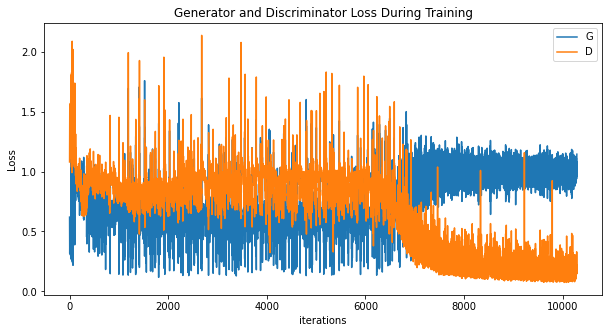

In [47]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

## нужно было остановить на семитысячной итерации, дальше модель пошла не туда

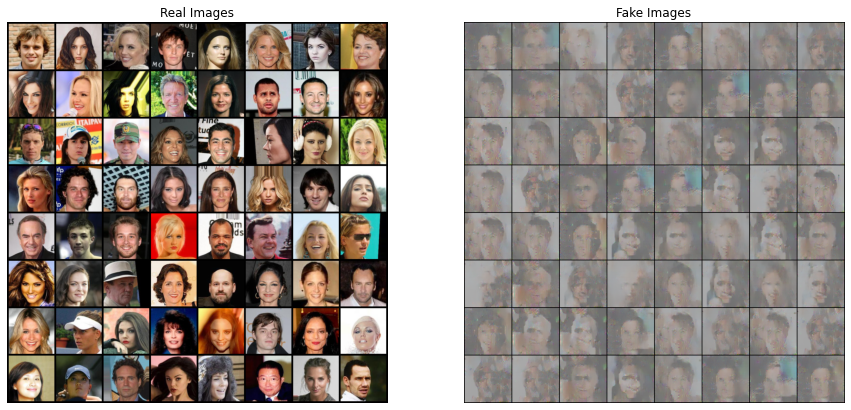

In [48]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(celeba_dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[:64].to(device), padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0))[:1042])
plt.show()

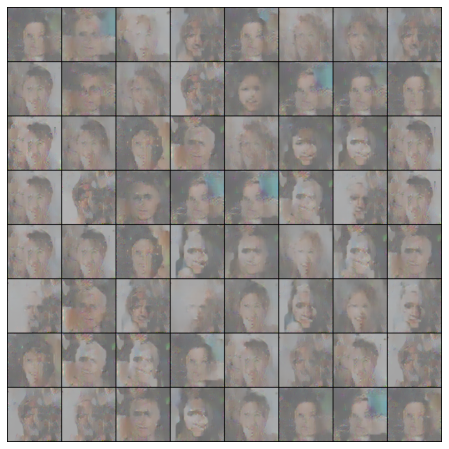

In [49]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
np.transpose(img_list[-1],(1,2,0))[:1042]
ims = [[plt.imshow(np.transpose(i,(1,2,0))[:1042], animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())